In [1]:
# Upload your kaggle.json file to your Colab environment before running this cell.
! pip install kaggle
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json

!pip install -U ydata-profiling

cp: cannot stat 'kaggle.json': No such file or directory
chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory


In [14]:
# Install dependencies as needed:
# pip install kagglehub[pandas-datasets]
import kagglehub
from kagglehub import KaggleDatasetAdapter

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('whitegrid')

# Set the path to the file you'd like to load
file_path = "US_Accidents_March23.csv"

# Load the latest version
df = kagglehub.load_dataset(
  KaggleDatasetAdapter.PANDAS,
  "sobhanmoosavi/us-accidents",
  file_path,
)

print("First 5 records:", df.head())

First 5 records:     ID   Source  Severity           Start_Time             End_Time  \
0  A-1  Source2         3  2016-02-08 05:46:00  2016-02-08 11:00:00   
1  A-2  Source2         2  2016-02-08 06:07:59  2016-02-08 06:37:59   
2  A-3  Source2         2  2016-02-08 06:49:27  2016-02-08 07:19:27   
3  A-4  Source2         3  2016-02-08 07:23:34  2016-02-08 07:53:34   
4  A-5  Source2         2  2016-02-08 07:39:07  2016-02-08 08:09:07   

   Start_Lat  Start_Lng  End_Lat  End_Lng  Distance(mi)  ... Roundabout  \
0  39.865147 -84.058723      NaN      NaN          0.01  ...      False   
1  39.928059 -82.831184      NaN      NaN          0.01  ...      False   
2  39.063148 -84.032608      NaN      NaN          0.01  ...      False   
3  39.747753 -84.205582      NaN      NaN          0.01  ...      False   
4  39.627781 -84.188354      NaN      NaN          0.01  ...      False   

  Station   Stop Traffic_Calming Traffic_Signal Turning_Loop Sunrise_Sunset  \
0   False  False          

In [15]:
df.head(5)

,ID,Source,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),...,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
0,A-1,Source2,3,2016-02-08 05:46:00,2016-02-08 11:00:00,39.865147,-84.058723,NaN,NaN,0.01,...,False,False,False,False,False,False,Night,Night,Night,Night
1,A-2,Source2,2,2016-02-08 06:07:59,2016-02-08 06:37:59,39.928059,-82.831184,NaN,NaN,0.01,...,False,False,False,False,False,False,Night,Night,Night,Day
2,A-3,Source2,2,2016-02-08 06:49:27,2016-02-08 07:19:27,39.063148,-84.032608,NaN,NaN,0.01,...,False,False,False,False,True,False,Night,Night,Day,Day
3,A-4,Source2,3,2016-02-08 07:23:34,2016-02-08 07:53:34,39.747753,-84.205582,NaN,NaN,0.01,...,False,False,False,False,False,False,Night,Day,Day,Day
4,A-5,Source2,2,2016-02-08 07:39:07,2016-02-08 08:09:07,39.627781,-84.188354,NaN,NaN,0.01,...,False,False,False,False,True,False,Day,Day,Day,Day


In [16]:
df.shape
#more then 7 millon rows

(7728394, 46)

In [17]:
df.columns


Index(['ID', 'Source', 'Severity', 'Start_Time', 'End_Time', 'Start_Lat',
       'Start_Lng', 'End_Lat', 'End_Lng', 'Distance(mi)', 'Description',
       'Street', 'City', 'County', 'State', 'Zipcode', 'Country', 'Timezone',
       'Airport_Code', 'Weather_Timestamp', 'Temperature(F)', 'Wind_Chill(F)',
       'Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 'Wind_Direction',
       'Wind_Speed(mph)', 'Precipitation(in)', 'Weather_Condition', 'Amenity',
       'Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit', 'Railway',
       'Roundabout', 'Station', 'Stop', 'Traffic_Calming', 'Traffic_Signal',
       'Turning_Loop', 'Sunrise_Sunset', 'Civil_Twilight', 'Nautical_Twilight',
       'Astronomical_Twilight'],
      dtype='object')

In [18]:
#datatypes of each column
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7728394 entries, 0 to 7728393
Data columns (total 46 columns):
 #   Column                 Dtype  
---  ------                 -----  
 0   ID                     object 
 1   Source                 object 
 2   Severity               int64  
 3   Start_Time             object 
 4   End_Time               object 
 5   Start_Lat              float64
 6   Start_Lng              float64
 7   End_Lat                float64
 8   End_Lng                float64
 9   Distance(mi)           float64
 10  Description            object 
 11  Street                 object 
 12  City                   object 
 13  County                 object 
 14  State                  object 
 15  Zipcode                object 
 16  Country                object 
 17  Timezone               object 
 18  Airport_Code           object 
 19  Weather_Timestamp      object 
 20  Temperature(F)         float64
 21  Wind_Chill(F)          float64
 22  Humidity(%)       

In [24]:
#!pip install pandas-profiling==3.1.0
import pandas as pd
from ydata_profiling import ProfileReport

profile = ProfileReport(df, title="Data Profiling Report", explorative=True)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 46/46 [09:38<00:00, 12.58s/it]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
#perform some stats on numerical dataset
df.describe(include='all')

,ID,Source,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),...,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
count,7728394,7728394,7.728394e+06,7728394,7728394,7.728394e+06,7.728394e+06,4.325632e+06,4.325632e+06,7.728394e+06,...,7728394,7728394,7728394,7728394,7728394,7728394,7705148,7705148,7705148,7705148
unique,7728394,3,NaN,6131796,6705355,NaN,NaN,NaN,NaN,NaN,...,2,2,2,2,2,1,2,2,2,2
top,A-7777761,Source1,NaN,2021-01-26 16:16:13,2021-11-22 08:00:00,NaN,NaN,NaN,NaN,NaN,...,False,False,False,False,False,False,Day,Day,Day,Day
freq,1,4325632,NaN,225,112,NaN,NaN,NaN,NaN,NaN,...,7728145,7526493,7514023,7720796,6584622,7728394,5334553,5695619,6076156,6377548
mean,NaN,NaN,2.212384e+00,NaN,NaN,3.620119e+01,-9.470255e+01,3.626183e+01,-9.572557e+01,5.618423e-01,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,4.875313e-01,NaN,NaN,5.076079e+00,1.739176e+01,5.272905e+00,1.810793e+01,1.776811e+00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,1.000000e+00,NaN,NaN,2.455480e+01,-1.246238e+02,2.456601e+01,-1.245457e+02,0.000000e+00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,2.000000e+00,NaN,NaN,3.339963e+01,-1.172194e+02,3.346207e+01,-1.177543e+02,0.000000e+00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,2.000000e+00,NaN,NaN,3.582397e+01,-8.776662e+01,3.618349e+01,-8.802789e+01,3.000000e-02,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,NaN,2.000000e+00,NaN,NaN,4.008496e+01,-8.035368e+01,4.017892e+01,-8.024709e+01,4.640000e-01,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
#counting number of missing values in each column and sorting them in descending order
missing_value = df.isna().sum().sort_values(ascending=False)
missing_value

,0
End_Lng,3402762
End_Lat,3402762
Precipitation(in),2203586
Wind_Chill(F),1999019
Wind_Speed(mph),571233
Visibility(mi),177098
Wind_Direction,175206
Humidity(%),174144
Weather_Condition,173459
Temperature(F),163853


In [ ]:
#converting value to percent to get better idea of data
percent_missing = (missing_value/ len(df))* 100
percent_missing

,0
End_Lng,44.029355
End_Lat,44.029355
Precipitation(in),28.512858
Wind_Chill(F),25.865904
Wind_Speed(mph),7.391355
Visibility(mi),2.291524
Wind_Direction,2.267043
Humidity(%),2.253301
Weather_Condition,2.244438
Temperature(F),2.120143


<Axes: >

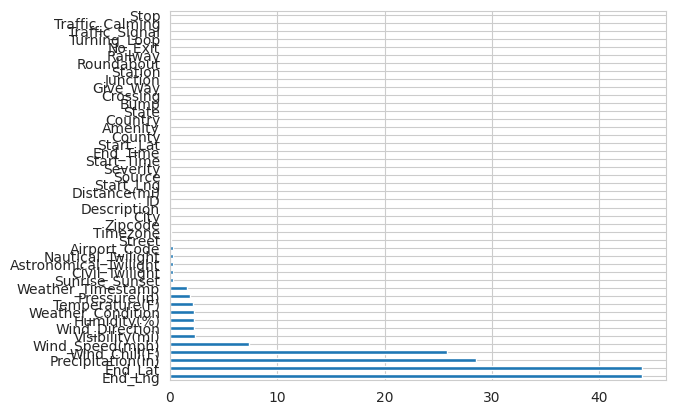

In [ ]:
percent_missing.plot(kind='barh')

<Axes: >

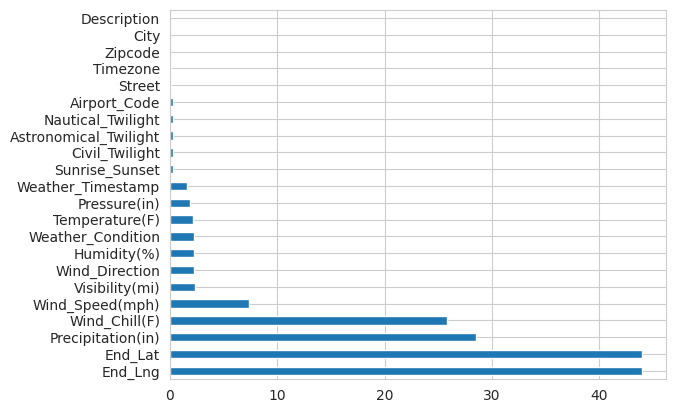

In [ ]:

#the above bar chart doesnt give better understanding as there are lot of columns with missing values
#so we plot only the columns without missing values
percent_missing[percent_missing!=0].plot(kind='barh')

In [ ]:
df.columns


Index(['ID', 'Source', 'Severity', 'Start_Time', 'End_Time', 'Start_Lat',
       'Start_Lng', 'End_Lat', 'End_Lng', 'Distance(mi)', 'Description',
       'Street', 'City', 'County', 'State', 'Zipcode', 'Country', 'Timezone',
       'Airport_Code', 'Weather_Timestamp', 'Temperature(F)', 'Wind_Chill(F)',
       'Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 'Wind_Direction',
       'Wind_Speed(mph)', 'Precipitation(in)', 'Weather_Condition', 'Amenity',
       'Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit', 'Railway',
       'Roundabout', 'Station', 'Stop', 'Traffic_Calming', 'Traffic_Signal',
       'Turning_Loop', 'Sunrise_Sunset', 'Civil_Twilight', 'Nautical_Twilight',
       'Astronomical_Twilight'],
      dtype='object')

In [ ]:

df.City


,City
0,Dayton
1,Reynoldsburg
2,Williamsburg
3,Dayton
4,Dayton
...,...
7728389,Riverside
7728390,San Diego
7728391,Orange
7728392,Culver City


In [ ]:
cities = df.City


In [ ]:

#unique number of cities
cities.nunique()

13678

In [ ]:

cities_by_accident = cities.value_counts()
cities_by_accident

,count
City,
Miami,186917
Houston,169609
Los Angeles,156491
Charlotte,138652
Dallas,130939
...,...
Rapid River,1
Cat Spring,1
Glenwood City,1


<Axes: ylabel='City'>

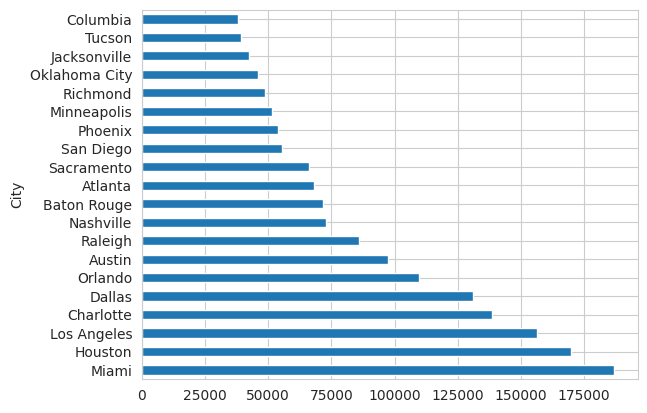

In [ ]:

#plotting top 20 cities which creates better visuals
cities_by_accident[:20].plot(kind='barh')

/tmp/ipython-input-42-521136022.py:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(cities_by_accident)


<Axes: xlabel='count', ylabel='Density'>

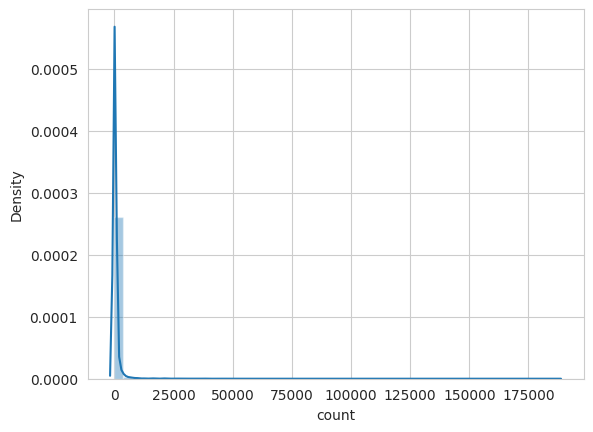

In [ ]:

#plotting dist plot to get better idea
sns.distplot(cities_by_accident)

In [ ]:

#the above dist plot doesnt give much insights about the data
#we can take citites with more than 1000 accidents
high_accidents = cities_by_accident[cities_by_accident > 1000]
high_accidents

,count
City,
Miami,186917
Houston,169609
Los Angeles,156491
Charlotte,138652
Dallas,130939
...,...
Coalinga,1006
West Hempstead,1003
Gulf Breeze,1003


In [ ]:

#checking how much percent of the cities have more than 1000 accidents
percent_high_acc = (len(high_accidents)/ cities.nunique())* 100
percent_high_acc

8.882877613686212

<Axes: xlabel='count', ylabel='Count'>

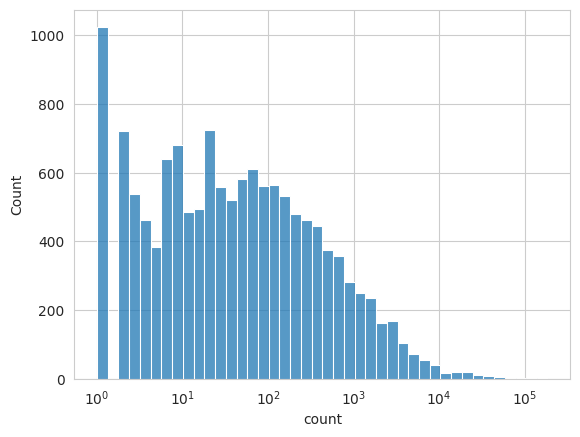

In [ ]:
#to get btter insights, plotting hist plot with log scale
sns.histplot(cities_by_accident, log_scale=True)

In [ ]:
cities_by_accident[cities_by_accident == 1]


,count
City,
American Fork-Pleasant Grove,1
Waldoboro,1
Kinsley,1
Killona,1
Jeanerette,1
...,...
Rapid River,1
Cat Spring,1
Glenwood City,1


In [ ]:
cities_by_accident[cities_by_accident < 10]


,count
City,
Dana,9
Wawaka,9
Gilmanton Iron Works,9
Cowansville,9
Ladora,9
...,...
Rapid River,1
Cat Spring,1
Glenwood City,1


In [ ]:
df.Start_Time


,Start_Time
0,2016-02-08 05:46:00
1,2016-02-08 06:07:59
2,2016-02-08 06:49:27
3,2016-02-08 07:23:34
4,2016-02-08 07:39:07
...,...
7728389,2019-08-23 18:03:25
7728390,2019-08-23 19:11:30
7728391,2019-08-23 19:00:21
7728392,2019-08-23 19:00:21


In [ ]:
df.Start_Time[0]


'2016-02-08 05:46:00'

In [ ]:
#the above data is String datatype in Datetime format
#Changing the datatype to datatime
df.Start_Time = pd.to_datetime(df.Start_Time, format='mixed')
df.Start_Time

,Start_Time
0,2016-02-08 05:46:00
1,2016-02-08 06:07:59
2,2016-02-08 06:49:27
3,2016-02-08 07:23:34
4,2016-02-08 07:39:07
...,...
7728389,2019-08-23 18:03:25
7728390,2019-08-23 19:11:30
7728391,2019-08-23 19:00:21
7728392,2019-08-23 19:00:21


/tmp/ipython-input-51-694067675.py:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df.Start_Time.dt.hour, bins=24, norm_hist=True ,kde=False)


<Axes: xlabel='Start_Time'>

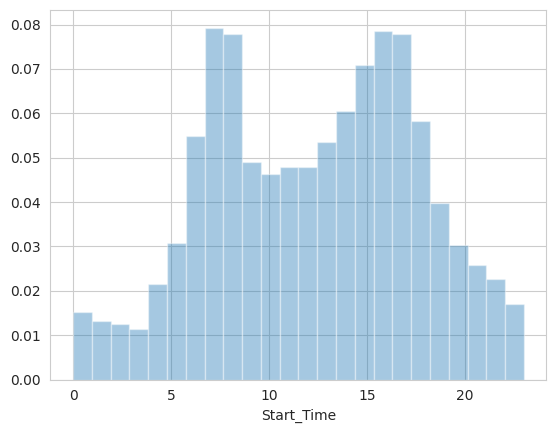

In [ ]:

#it is best to visualize the hourly data along with normalizing and bins is 24 as there are 24 hours in a day
sns.distplot(df.Start_Time.dt.hour, bins=24, norm_hist=True ,kde=False)

/tmp/ipython-input-52-1815109718.py:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df.Start_Time.dt.dayofweek, bins=7, norm_hist=True, kde=False)


<Axes: xlabel='Start_Time'>

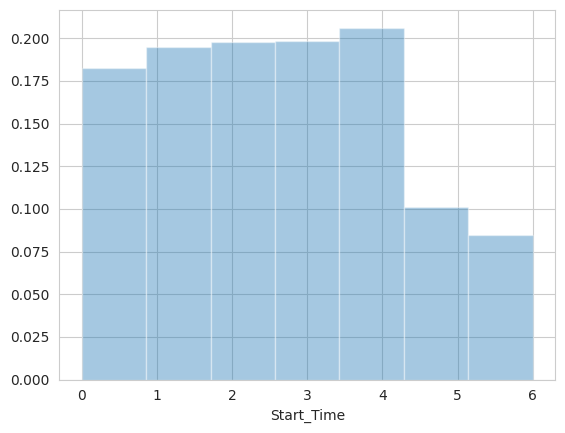

In [ ]:

#to know which day of the week the accidents occur more often
sns.distplot(df.Start_Time.dt.dayofweek, bins=7, norm_hist=True, kde=False)

/tmp/ipython-input-53-3208387742.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(sat_data.dt.hour, bins=24, norm_hist=True, kde=False)


<Axes: xlabel='Start_Time'>

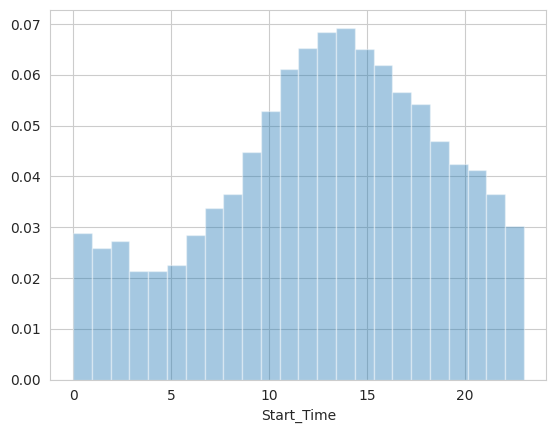

In [ ]:

#exploring weekend date(Saturday)
sat_data = df.Start_Time[df.Start_Time.dt.dayofweek==5]
sns.distplot(sat_data.dt.hour, bins=24, norm_hist=True, kde=False)

In [ ]:
df.Start_Lat

,Start_Lat
0,39.865147
1,39.928059
2,39.063148
3,39.747753
4,39.627781
...,...
7728389,34.002480
7728390,32.766960
7728391,33.775450
7728392,33.992460


In [ ]:
df.Start_Lng


,Start_Lng
0,-84.058723
1,-82.831184
2,-84.032608
3,-84.205582
4,-84.188354
...,...
7728389,-117.379360
7728390,-117.148060
7728391,-117.847790
7728392,-118.403020


In [ ]:
#Creating sample out of main df for getting better visualization of data(10% of total rows)
sample_df = df.sample(int(0.1* len(df)))
sample_df

,ID,Source,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),...,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
1105386,A-1115159,Source2,3,2021-03-18 17:46:21,2021-03-18 18:15:50,32.647579,-96.884766,NaN,NaN,0.000,...,False,False,False,False,False,False,Day,Day,Day,Day
4782535,A-4818830,Source1,2,2023-01-04 14:45:00,2023-01-04 18:55:00,30.476153,-97.672543,30.512477,-97.686811,2.650,...,False,False,False,False,False,False,Day,Day,Day,Day
3085587,A-3095466,Source2,2,2018-01-30 11:39:29,2018-01-30 12:08:47,42.421036,-87.855011,NaN,NaN,0.000,...,False,False,False,False,True,False,Day,Day,Day,Day
4960212,A-4997817,Source1,2,2022-12-03 17:23:30,2022-12-03 18:54:00,33.856783,-117.975181,33.854017,-117.937554,2.167,...,False,False,False,False,False,False,Night,Night,Day,Day
1461488,A-1471327,Source2,2,2020-05-15 09:44:32,2020-05-15 10:53:10,33.451271,-111.909302,NaN,NaN,0.000,...,False,False,False,False,True,False,Day,Day,Day,Day
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4339434,A-4372249,Source1,2,2022-06-08 15:31:32,2022-06-08 19:46:45.000000000,40.760766,-74.003906,40.765844,-74.021432,0.982,...,False,False,False,False,False,False,Day,Day,Day,Day
2059169,A-2069032,Source2,3,2019-06-24 12:56:55,2019-06-24 14:28:10,44.918785,-93.275063,NaN,NaN,0.000,...,False,False,False,False,False,False,Day,Day,Day,Day
1486522,A-1496361,Source2,2,2020-06-05 15:49:45,2020-06-05 16:49:29,42.994320,-73.921837,NaN,NaN,0.000,...,False,False,False,False,False,False,Day,Day,Day,Day
6398814,A-6446016,Source1,2,2021-02-23 03:16:00,2021-02-23 04:41:54,33.913436,-118.123886,33.913284,-118.127713,0.220,...,False,False,False,False,False,False,Night,Night,Night,Night


<Axes: xlabel='Start_Lng', ylabel='Start_Lat'>

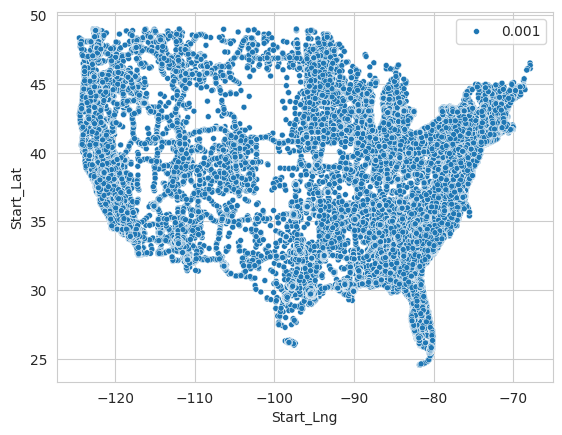

In [ ]:
sns.scatterplot(x=sample_df.Start_Lng, y= sample_df.Start_Lat, size=0.001)


**Insights:**

Less than 4.5% of cities or a total of 494 Cities had more than 1000 accidents
There is no New York city Data in the dataset
More than 4400 cities have less than 10 Accidents over a period of 6 Years
During weekdays most of the accidents happened during 06AM to 09AM and 03PM to 06PM may be because this is the time for office and home commute
Weekend Chart is bell curve quite opposite to weekday accidents and has happened b/w 10AM to 03PM
Accidents were more in the Coastal areas and centre region seems to be less accident prone zone

## Prepare time data

### Subtask:
Extract the hour of the day and day of the week from the `Start_Time` column.


**Reasoning**:
Extract the hour and day of the week from the Start_Time column and create new columns for each.



In [ ]:
df['Hour'] = df.Start_Time.dt.hour
df['Day_of_Week'] = df.Start_Time.dt.dayofweek

**Reasoning**:
Display the first few rows of the DataFrame with the new columns to verify the extraction.



In [ ]:
display(df.head())

,ID,Source,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),...,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight,Hour,Day_of_Week
0,A-1,Source2,3,2016-02-08 05:46:00,2016-02-08 11:00:00,39.865147,-84.058723,NaN,NaN,0.01,...,False,False,False,False,Night,Night,Night,Night,5,0
1,A-2,Source2,2,2016-02-08 06:07:59,2016-02-08 06:37:59,39.928059,-82.831184,NaN,NaN,0.01,...,False,False,False,False,Night,Night,Night,Day,6,0
2,A-3,Source2,2,2016-02-08 06:49:27,2016-02-08 07:19:27,39.063148,-84.032608,NaN,NaN,0.01,...,False,False,True,False,Night,Night,Day,Day,6,0
3,A-4,Source2,3,2016-02-08 07:23:34,2016-02-08 07:53:34,39.747753,-84.205582,NaN,NaN,0.01,...,False,False,False,False,Night,Day,Day,Day,7,0
4,A-5,Source2,2,2016-02-08 07:39:07,2016-02-08 08:09:07,39.627781,-84.188354,NaN,NaN,0.01,...,False,False,True,False,Day,Day,Day,Day,7,0


## Group and count accidents

### Subtask:
Group the DataFrame by day of the week and hour of the day, and count the number of accidents for each group.


**Reasoning**:
Group the DataFrame by day of the week and hour of the day and count the number of accidents.



In [ ]:
accidents_by_day_hour = df.groupby(['Day_of_Week', 'Hour']).size().unstack()
display(accidents_by_day_hour)

Hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Day_of_Week,,,,,,,,,,,,,,,,,,,,,
0,13895,11676,11397,11316,26924,39925,72150,102664,101378,59123,...,67504,82437,93133,92492,66108,43231,32308,25807,22339,16270
1,14591,11929,10576,10066,24196,39948,78821,118920,116741,65297,...,69849,86912,100804,102421,73030,45035,32578,26300,22947,17168
2,15138,12741,11348,10457,25518,40481,78383,117174,114417,65726,...,71774,88464,101482,104387,74474,46863,34213,27882,24534,17944
3,15656,13487,12300,11383,26377,40302,74877,112497,109284,63699,...,74608,91157,103133,104263,73388,47894,35162,29302,25841,18414
4,16299,14029,13224,12445,29408,39392,67214,96292,94220,59610,...,84826,101181,110755,104944,80560,55489,39799,32802,29478,21630
5,18443,16581,17520,13733,13739,14518,18225,21687,23467,28713,...,44412,41687,39715,36270,34731,30075,27191,26437,23369,19356
6,18356,16628,16862,14463,13690,13616,16167,18238,18069,20866,...,35873,34017,32947,31238,29751,26534,23975,22922,19137,15757


## Create a pivot table

### Subtask:
Reshape the grouped data into a pivot table with days of the week as rows and hours of the day as columns.


**Reasoning**:
Verify the structure of the accidents_by_day_hour DataFrame to ensure it is in the correct pivot table format.



In [ ]:
display(accidents_by_day_hour.head())

Hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Day_of_Week,,,,,,,,,,,,,,,,,,,,,
0,13895,11676,11397,11316,26924,39925,72150,102664,101378,59123,...,67504,82437,93133,92492,66108,43231,32308,25807,22339,16270
1,14591,11929,10576,10066,24196,39948,78821,118920,116741,65297,...,69849,86912,100804,102421,73030,45035,32578,26300,22947,17168
2,15138,12741,11348,10457,25518,40481,78383,117174,114417,65726,...,71774,88464,101482,104387,74474,46863,34213,27882,24534,17944
3,15656,13487,12300,11383,26377,40302,74877,112497,109284,63699,...,74608,91157,103133,104263,73388,47894,35162,29302,25841,18414
4,16299,14029,13224,12445,29408,39392,67214,96292,94220,59610,...,84826,101181,110755,104944,80560,55489,39799,32802,29478,21630


## Visualize with a heatmap

### Subtask:
Create a heatmap to visualize the distribution of accidents across hours and days.


**Reasoning**:
Create a heatmap to visualize the distribution of accidents across hours and days using the accidents_by_day_hour DataFrame.



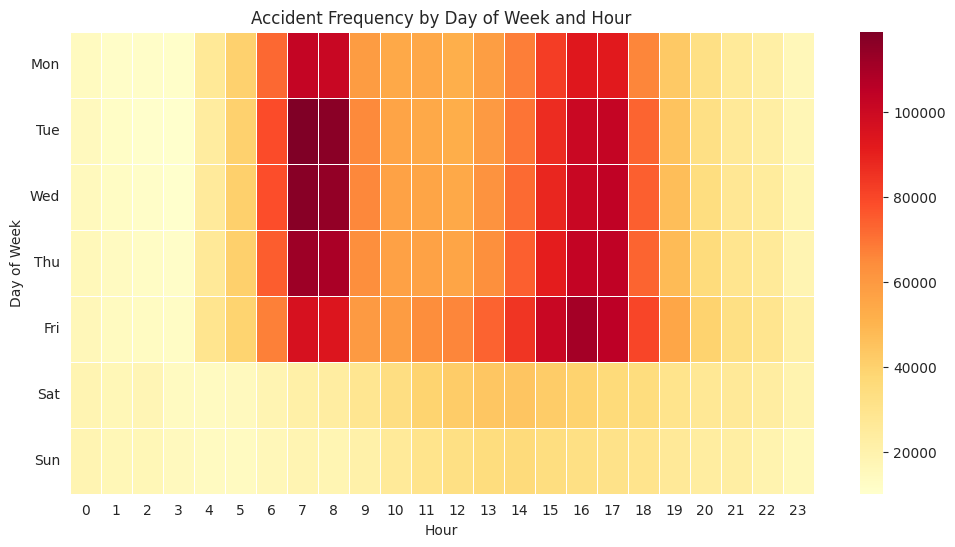

In [ ]:
plt.figure(figsize=(12, 6))
sns.heatmap(accidents_by_day_hour, cmap="YlOrRd", linewidths=.5)
plt.xlabel('Hour')
plt.ylabel('Day of Week')
plt.title('Accident Frequency by Day of Week and Hour')
plt.yticks(np.arange(7) + 0.5, ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun'], rotation=0)
plt.show()

## Interpret and summarize

### Subtask:
Analyze the heatmap to identify patterns and summarize the key insights.


In [ ]:
weather_counts = df['Weather_Condition'].value_counts()
display(weather_counts.head(20))

,count
Weather_Condition,
Fair,2560802
Mostly Cloudy,1016195
Cloudy,817082
Clear,808743
Partly Cloudy,698972
Overcast,382866
Light Rain,352957
Scattered Clouds,204829
Light Snow,128680


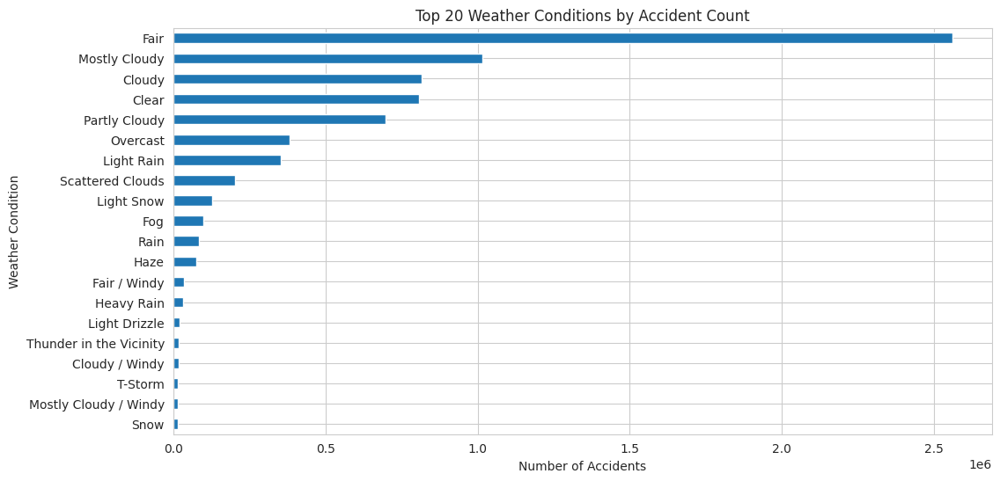

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
weather_counts.head(20).plot(kind='barh')
plt.xlabel('Number of Accidents')
plt.ylabel('Weather Condition')
plt.title('Top 20 Weather Conditions by Accident Count')
plt.gca().invert_yaxis() # Invert y-axis to show the highest count at the top
plt.show()

## Summary:

### Data Analysis Key Findings

* The visualization shows that the majority of accidents occur during "Fair" weather conditions, followed by "Mostly Cloudy" and "Cloudy". This might seem counterintuitive but is likely due to the fact that fair weather is the most common weather condition overall.
* However, conditions like "Light Rain", "Heavy Rain", "Light Snow", and "Fog" also contribute significantly to the number of accidents, indicating that adverse weather conditions do play a role.

In [ ]:
poi_columns = [
    'Amenity', 'Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit',
    'Railway', 'Roundabout', 'Station', 'Stop', 'Traffic_Calming',
    'Traffic_Signal'
]
print(poi_columns)

['Amenity', 'Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit', 'Railway', 'Roundabout', 'Station', 'Stop', 'Traffic_Calming', 'Traffic_Signal']


## Analyze feature frequencies at accident locations

### Subtask:
For each selected feature, determine how many accidents occurred at locations where the feature is present.


**Reasoning**:
Calculate the sum of True values for each POI column to get the accident count for each feature and display the results.



In [ ]:
feature_accident_counts = df[poi_columns].sum()
display(feature_accident_counts)

,0
Amenity,96334
Bump,3514
Crossing,873763
Give_Way,36582
Junction,571342
No_Exit,19545
Railway,66979
Roundabout,249
Station,201901
Stop,214371


## Visualize feature impact


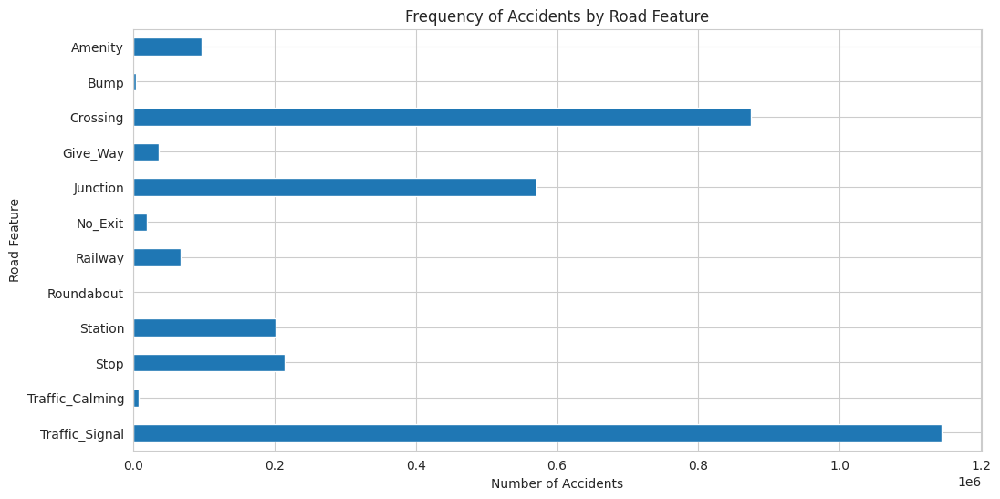

In [ ]:
plt.figure(figsize=(12, 6))
feature_accident_counts.plot(kind='barh')
plt.xlabel('Number of Accidents')
plt.ylabel('Road Feature')
plt.title('Frequency of Accidents by Road Feature')
plt.gca().invert_yaxis()
plt.show()

## Interpret and summarize

### Subtask:
Analyze the visualization to identify patterns and summarize the key insights about the relationship between features and accident frequency.


## Summary:

### Data Analysis Key Findings

*   The road features most frequently present at accident locations are `Junction` and `Crossing`.
*   The road features least frequently present at accident locations are `Roundabout`, `Station`, and `Traffic Circle`.
